In [1]:
import json
from mesa import Agent, Model
from mesa.time import RandomActivation, SimultaneousActivation
import numpy as np
import geopandas as gpd
import contextily as ctx
from mesa.datacollection import DataCollector
import skmob
import time
from mesa.batchrunner import BatchRunnerMP
import pickle
import networkx as nx
import osmnx as ox
import pandas as pd
from tqdm import tqdm
from datetime import datetime
from shapely.geometry import Point, LineString

# Load regions and roads graph

In [2]:
regions = gpd.read_file('../../data/raw/EtapII-REJONY_wroclaw.shp')

In [3]:
with open('graf_drog', 'rb') as f:
    G = pickle.load(f)

In [4]:
G.number_of_nodes()

7047

In [5]:
nodes, data = zip(*G.nodes(data=True))

In [6]:
data[0]

{'y': 51.0831108, 'x': 17.0495131, 'osmid': 95584835}

In [7]:
G = G.to_undirected()

In [8]:
pos = {d[0]: (d[1]['x'], d[1]['y']) for d in list(G.nodes(data=True))}

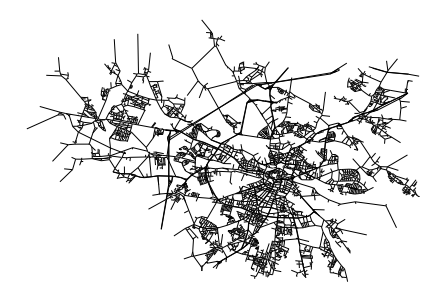

In [9]:
nx.draw(G, pos=pos, node_size=0)

In [10]:
ox.folium.plot_graph_folium(G)

In [11]:
interregional_travels = gpd.read_file('../../data/raw/EtapV-11_Wiezba_ruchu_SIM_podroze-miedzyrejonowe.shp')

interregional_travels.rename(
    columns={
        'REJ_ZRODLO': 'ORIGIN',
        'REJ_CEL': 'DESTINATION'
    },
    inplace=True
)
interregional_travels = interregional_travels[interregional_travels['ORIGIN'].isin(regions['NUMBER'])]
interregional_travels = interregional_travels[interregional_travels['DESTINATION'].isin(regions['NUMBER'])]

inter_travels = pd.DataFrame(columns=['HOUR', 'ORIGIN', 'DESTINATION', 'FLOW'])

for i in tqdm(range(24)):
    sub_df = interregional_travels[['DESTINATION', 'ORIGIN', f'H_{i}']]
    sub_df.rename(
        columns={
            f'H_{i}': 'FLOW'
        },
        inplace=True
    )
    # sub_df['HOUR'] = f'{str(i)}:00:00'
    sub_df['HOUR'] = datetime(2020, 1, 1, i, 1, 0)
    inter_travels = inter_travels.append(sub_df, ignore_index=True)

inter_travels = inter_travels[['ORIGIN', 'DESTINATION', 'FLOW']].groupby(['ORIGIN', 'DESTINATION']).sum().reset_index()

100%|██████████| 24/24 [00:01<00:00, 12.07it/s]


In [32]:
regions = regions.to_crs(epsg=4326)

In [33]:
fdf = skmob.FlowDataFrame(
    data=inter_travels,
    origin='ORIGIN',
    destination='DESTINATION',
    flow='FLOW',
    tile_id='NUMBER',
    tessellation=regions
)

In [34]:
m = fdf.plot_tessellation(tiles='OpenStreetMap')
fdf.plot_flows(m, tiles='OpenStreetMap', min_flow=5000, flow_weight=2)

In [35]:
ox.folium.plot_graph_folium(G, graph_map=m)

In [15]:
n = list(G.nodes(data=True))[0][1]

In [16]:
n

{'y': 51.0831108, 'x': 17.0495131, 'osmid': 95584835}

In [17]:
# p = Point(n['x'], n['y'])

In [18]:
# for region_num in tqdm(regions['NUMBER'].to_list()):
#     shape = regions[regions['NUMBER'] == region_num].iloc[0]['geometry']
#     if shape.intersects(p):
#         print(region_num)

In [19]:
region_nodes = {}
for region_num in regions['NUMBER'].to_list():
    region_nodes[region_num] = []

for node in tqdm(list(G.nodes(data=True))):

    n = node[1]
    p = Point(n['x'], n['y'])

    for region_num in regions['NUMBER'].to_list():
        shape = regions[regions['NUMBER'] == region_num].iloc[0]['geometry']
        if shape.intersects(p):
            region_nodes[region_num].append(node)

100%|██████████| 7047/7047 [1:10:18<00:00,  1.67it/s]


In [24]:
for k, v in region_nodes.items():
    region_nodes[k] = list(map(lambda x: x[0], region_nodes[k]))

In [26]:
with open('region_nodes.json', 'w') as outfile:
    json.dump(region_nodes, outfile)